<a href="https://colab.research.google.com/github/ClaudiaTurner/GEOG5990M/blob/main/Assignment1_GEOG5990M_Portfolio_Jupyter.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# GEOG5990M Portfolio assignment


Student ID number: 201893759



##1. Block One Submission
Using data introduced in the course create a visualisation showing the association between two variables. Using skills developed in the practical exercises take any steps required to clean or pre-process the data.  It is expected that you wills change the default appearance of the markers and include an appropriate title and axis labels. Further marks will be awarded for appropriate use of colour pallets, inclusion of additional categorical variables in the visualisation and other steps taken to ensure effective data visualisation.

Ensure all the code has detialed comments.

Write a brief paragraph in markdown (max. 300 words) detailing the visualisation choices made given the types of data you have chosen.

**1.1 IMPORT PACKAGES AND UPLOAD DATA**

In [ ]:
# IMPORT REQUIRED PACKAGES FOR:

# Statistical data visualization (e.g., scatter plots)
import seaborn as sns

# Numerical array operations (e.g., calculate the total amount)
import numpy as np

# Plotting and visualisation (e.g., Add a title to the plot)
import matplotlib.pyplot as plt

# Text and path effects
## Copilot suggested adding the required package to create an outline around the legend
import matplotlib.patheffects as path_effects


In [ ]:
# List all available datasets in the Seaborn library and choose one
sns.get_dataset_names()


['anagrams',
 'anscombe',
 'attention',
 'brain_networks',
 'car_crashes',
 'diamonds',
 'dots',
 'dowjones',
 'exercise',
 'flights',
 'fmri',
 'geyser',
 'glue',
 'healthexp',
 'iris',
 'mpg',
 'penguins',
 'planets',
 'seaice',
 'taxis',
 'tips',
 'titanic']

In [ ]:
# Load life expectancy (healthexp) data (1970-2020)
life_expectancy=sns.load_dataset('healthexp')

# Verify that the data was uploaded successfully
life_expectancy.head()


,Year,Country,Spending_USD,Life_Expectancy
0,1970,Germany,252.311,70.6
1,1970,France,192.143,72.2
2,1970,Great Britain,123.993,71.9
3,1970,Japan,150.437,72.0
4,1970,USA,326.961,70.9


**1.2 DATA EXPLORATION & PROCESSING**

In [ ]:
# Explore the attribute table columns
life_expectancy.columns


Index(['Year', 'Country', 'Spending_USD', 'Life_Expectancy'], dtype='object')

In [ ]:
# How many rows and columns does the attribute table have?
rows, columns = life_expectancy.shape

# Print the answer and add text to enhance readability
print(f"Rows: {rows}, Columns: {columns}")


Rows: 274, Columns: 4


In [ ]:
# With the .info function, observe if there are any null values in the data frame. And what are the data types of each variable?
life_expectancy.info()


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 274 entries, 0 to 273
Data columns (total 4 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   Year             274 non-null    int64  
 1   Country          274 non-null    object 
 2   Spending_USD     274 non-null    float64
 3   Life_Expectancy  274 non-null    float64
dtypes: float64(2), int64(1), object(1)
memory usage: 8.7+ KB


In [ ]:
# Rename Column: Changing 'Spending_USD' to 'MEDICAL_COSTS_USD'
life_expectancy.rename(columns={ 'Spending_USD': 'MEDICAL_COSTS_USD'}, inplace=True)

# Convert all column names to uppercase
life_expectancy.columns=life_expectancy.columns.str.upper()

# Checking the Table to Confirm Changes
print(life_expectancy)


     YEAR        COUNTRY  MEDICAL_COSTS_USD  LIFE_EXPECTANCY
0    1970        Germany            252.311             70.6
1    1970         France            192.143             72.2
2    1970  Great Britain            123.993             71.9
3    1970          Japan            150.437             72.0
4    1970            USA            326.961             70.9
..    ...            ...                ...              ...
269  2020        Germany           6938.983             81.1
270  2020         France           5468.418             82.3
271  2020  Great Britain           5018.700             80.4
272  2020          Japan           4665.641             84.7
273  2020            USA          11859.179             77.0

[274 rows x 4 columns]


In [ ]:
# Round LIFE_EXPECTANCY to Zero Decimal Places and Convert Float to Integer to Remove '.0'
life_expectancy['LIFE_EXPECTANCY']=life_expectancy['LIFE_EXPECTANCY'].round().astype(int)


# Round currency to one decimal place
life_expectancy['MEDICAL_COSTS_USD']=life_expectancy['MEDICAL_COSTS_USD'].round(1)

# Check for changes, lets look at the last 5 rows
life_expectancy.tail()


,YEAR,COUNTRY,MEDICAL_COSTS_USD,LIFE_EXPECTANCY
269,2020,Germany,6939.0,81
270,2020,France,5468.4,82
271,2020,Great Britain,5018.7,80
272,2020,Japan,4665.6,85
273,2020,USA,11859.2,77


In [ ]:
# How manny years are included in the data?
year_range=life_expectancy['YEAR'].nunique()

## I asked Copilot: 'How to add text label to my .nunique output'
year_range_label = f"The data includes a range of {year_range} years, covering the following countries and time periods:"

# Before printing the output, add space (\n) to enhance readability
print(year_range_label, "\n")

# What countries and years does the data include for average life expectancy?
print(life_expectancy['COUNTRY'].unique(),"\n")
print(life_expectancy['YEAR'].unique())


The data includes a range of 51 years, covering the following countries and time periods: 

['Germany' 'France' 'Great Britain' 'Japan' 'USA' 'Canada'] 

[1970 1971 1972 1973 1974 1975 1976 1977 1978 1979 1980 1981 1982 1983
 1984 1985 1986 1987 1988 1989 1990 1991 1992 1993 1994 1995 1996 1997
 1998 1999 2000 2001 2002 2003 2004 2005 2006 2007 2008 2009 2010 2011
 2012 2013 2014 2015 2016 2017 2018 2019 2020]


In [ ]:
# Which country or countries have had a life expectancy of 84 or higher, Since 2015?

Life_expectancy_2015=life_expectancy.loc[life_expectancy['YEAR']>=2015]
Life_expectancy_2015[Life_expectancy_2015['LIFE_EXPECTANCY']>=84]


,YEAR,COUNTRY,MEDICAL_COSTS_USD,LIFE_EXPECTANCY
242,2015,Japan,4515.6,84
248,2016,Japan,4295.9,84
254,2017,Japan,4412.9,84
260,2018,Japan,4554.3,84
266,2019,Japan,4610.8,84
272,2020,Japan,4665.6,85


In [ ]:
# Which countries recorded the highest  medical expenditures? List the top 10 highest spending instances, along with the corresponding country and year
top_medical_costs=life_expectancy.nlargest(10,'MEDICAL_COSTS_USD')[['YEAR', 'COUNTRY', 'MEDICAL_COSTS_USD']]

# Check the attribute table of the 'top_medical_costs' dataset, representing the top 10 highest medical expenditures with country names included
top_medical_costs


,YEAR,COUNTRY,MEDICAL_COSTS_USD
273,2020,USA,11859.2
267,2019,USA,10855.5
261,2018,USA,10451.4
255,2017,USA,10046.5
249,2016,USA,9717.6
243,2015,USA,9355.1
237,2014,USA,8925.9
231,2013,USA,8519.6
225,2012,USA,8346.1
219,2011,USA,8079.5



**1.3 NON-SPATIAL DATA VISUALIZATION AND NEW VARIABLE**

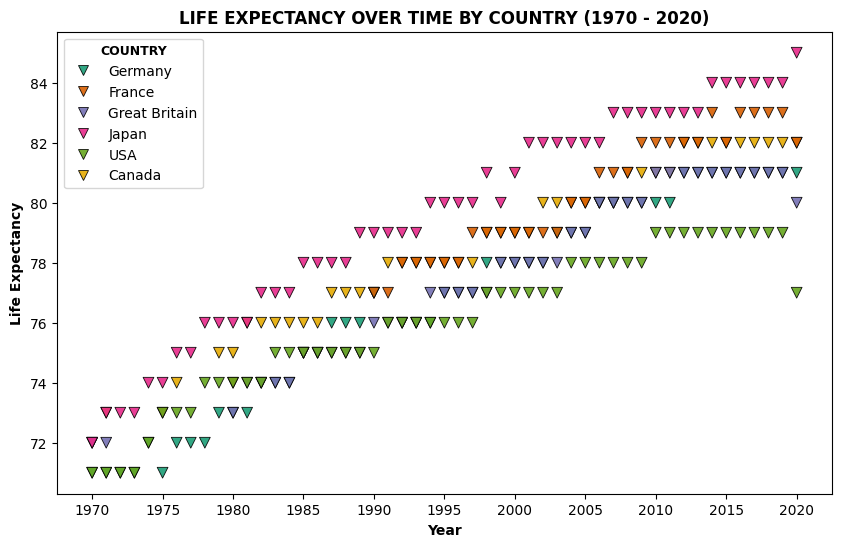

In [ ]:
# NON-SPATIAL DATA VISUALISATION

# Create the scatter plot using Seaborn and define the plot size
plt.figure(figsize=(10, 6))

# Define x and y axes, add a legend based on a reference column ('COUNTRY'), and customize color, transparency, marker size, and type
sns.scatterplot(data=life_expectancy, x='YEAR', y='LIFE_EXPECTANCY', hue='COUNTRY', palette='Dark2', edgecolor='black', alpha=0.9, s=60,marker='v')

# Set x-axis ticks at intervals of 5 years
## I asked GPT-4o: Help me difene interval of 5 years for axis 5 (the default has an interval of 10 years), tp run this code I had to import numpy

min_year = life_expectancy['YEAR'].min()
max_year = life_expectancy['YEAR'].max()
plt.xticks(np.arange(min_year, max_year + 1, 5))

# Add labels to x-axis and y-axis
plt.xlabel("Year", fontweight='bold')
plt.ylabel("Life Expectancy", fontweight='bold')

# Add a main title to the scatter plot and to the legend, both in bold.

plt.title("LIFE EXPECTANCY OVER TIME BY COUNTRY (1970 - 2020)",  fontweight='bold')
legend = plt.legend(title="COUNTRY")    # Name column ('COUNTRY') to reference in the legend
legend.get_title().set_fontsize('9')    # Define fontsize
legend.get_title().set_weight('bold')

# Show the plot
plt.show()


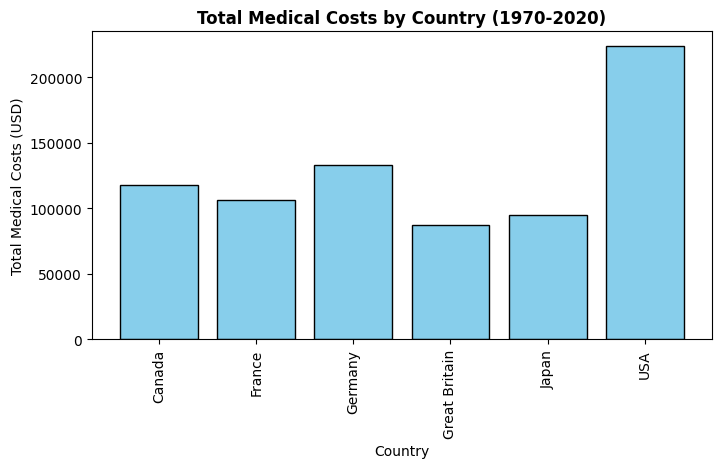

In [ ]:
# How much has each country spent on medical costs from 1970 to 2020? Create a new dataset containing the total cost per country by summing all years (1970–2020)
Total_Cost = life_expectancy.groupby('COUNTRY', as_index=False)['MEDICAL_COSTS_USD'].sum()

# Create the bar plot to visualize the output, define plot size,color, and select variables to display
plt.figure(figsize=(8, 4))
plt.bar(Total_Cost['COUNTRY'], Total_Cost['MEDICAL_COSTS_USD'], color='skyblue',edgecolor='black')

# Add labels to the bar plot, and set X = Country and Y = Total Cost
plt.xlabel("Country")
plt.ylabel("Total Medical Costs (USD)")

# Add main title in bold
plt.title("Total Medical Costs by Country (1970-2020)", fontweight='bold')

## I asked Copilot: How to rotate (90degrees) the label in x
# Rotate country names for better readability
plt.xticks(rotation=90)

# Show the plot
plt.show()


**NEW VARIABLE: MEDICAL_COST_GROWTH**

In [ ]:
# Add a new variable 'MEDICAL_COST_GROWTH' to calculate the year-over-year percentage change in medical costs for each country.
## I consulted Copilot to determine the appropriate function for calculating percentage change and, as a result, I added the .pct_change() function to my code.

life_expectancy['MEDICAL_COST_GROWTH'] = life_expectancy.groupby('COUNTRY')['MEDICAL_COSTS_USD'].pct_change() * 100

# Round the values of the new variable to one decimal place.
life_expectancy['MEDICAL_COST_GROWTH']=life_expectancy['MEDICAL_COST_GROWTH'].round(1)

# Verify that the new columns have been successfully added to the DataFrame, print the first seven rows.
print(life_expectancy.head(7))


   YEAR        COUNTRY  MEDICAL_COSTS_USD  LIFE_EXPECTANCY  \
0  1970        Germany              252.3               71   
1  1970         France              192.1               72   
2  1970  Great Britain              124.0               72   
3  1970          Japan              150.4               72   
4  1970            USA              327.0               71   
5  1971         Canada              313.4               73   
6  1971        Germany              298.3               71   

   MEDICAL_COST_GROWTH  
0                  NaN  
1                  NaN  
2                  NaN  
3                  NaN  
4                  NaN  
5                  NaN  
6                 18.2  


In [ ]:
# Check for null values in our new variable, print the Output with Explanation Text and Use '\n' for Better Readability
print('\n\n===== Null (NaN) values within the attrubute table =====\n')

# Print sum the total amount of null values within our new variable ('MEDICAL_COST_GROWTH')
print(life_expectancy.isnull().sum())




===== Null (NaN) values within the attrubute table =====

YEAR                   0
COUNTRY                0
MEDICAL_COSTS_USD      0
LIFE_EXPECTANCY        0
MEDICAL_COST_GROWTH    6
dtype: int64


In [ ]:
# Remove the six Null (NaN) Values visualised in column 'MEDICAL_COST_GROWTH', these are Caused by Missing Prior Year Data for the First Year (1970).
life_expectancy.dropna(inplace=True)

# Verify if NaN (null values) have been successfully removed from the DataFrame
life_expectancy.isnull().sum()


,0
YEAR,0
COUNTRY,0
MEDICAL_COSTS_USD,0
LIFE_EXPECTANCY,0
MEDICAL_COST_GROWTH,0


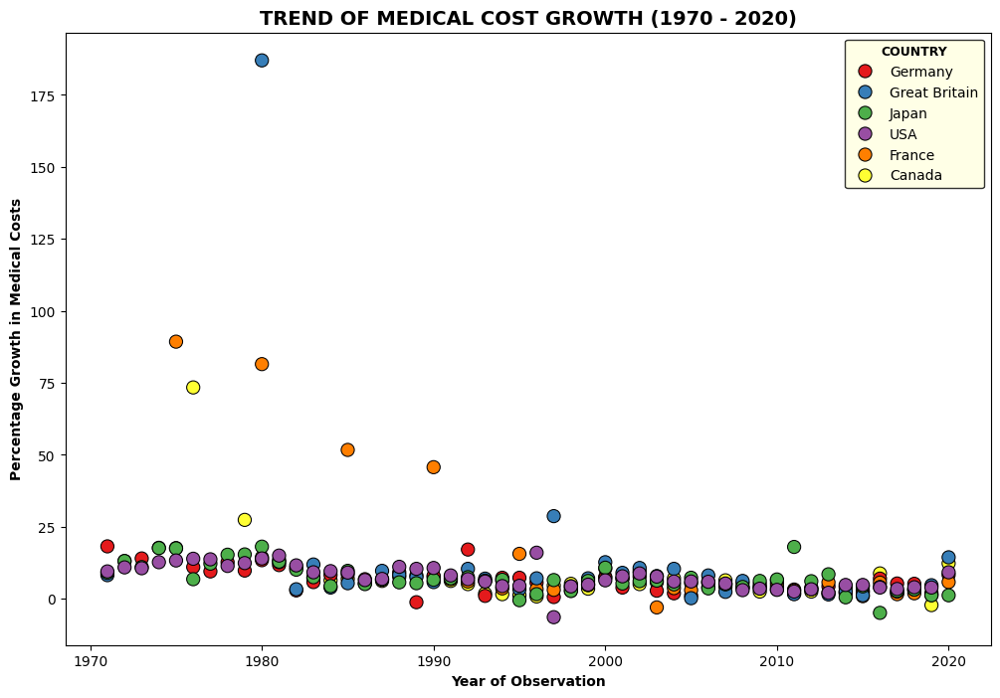

In [ ]:
# Visualise the newly created 'MEDICAL_COST_GROWTH' variable using a SCATTER PLOT.

# Define plot size
plt.figure(figsize=(12, 8))

# Use seaborn to create a scatter plot and customize: define data, set x and y axes, add a legend, and specify color, marker size, and type
sns.scatterplot(data=life_expectancy, x='YEAR', y='MEDICAL_COST_GROWTH',hue='COUNTRY', edgecolor='black', s=90, palette='Set1',marker='o');

# Add a main title and the legend, both in bold.

plt.title("TREND OF MEDICAL COST GROWTH (1970 - 2020)",  fontweight='bold',size=14) # Main title in bold and letter size 14
legend = plt.legend(title="COUNTRY")                                                # Add title to legend
legend.get_title().set_fontsize('9')                                                # Define legends fontsize
legend.get_title().set_weight('bold')                                               # Set legend to bold


# Add an outline to the legend box and set a grey fill color with a thin black outline.
## I asked Copilot how to add an outline and fill to the legend box to enhance readability.

frame = legend.get_frame()
frame.set_edgecolor('black')             # Define edgecolor
frame.set_linewidth(1)                   #  Define outline width
frame.set_facecolor('lightyellow')       # Add a light yellow bacground to the legend

# Axis labels (suitable and changed from the default), add a title (in bold) to X and Y axis.

plt.xlabel("Year of Observation",fontweight='bold')
plt.ylabel("Percentage Growth in Medical Costs",fontweight='bold')

plt.show()


### Block One Submission: Visualisation Choices

For Block 1, a non-spatial dataset on life expectancy (1970–2020) was used, downloaded from the Seaborn library in Python - Colab. The dataset includes information on year, country, Spending_USD, and Life_Expectancy for six selected countries: Germany, France, Great Britain, Japan, the USA, and Canada. Additionally, a new variable was created to calculate medical cost growth per country, representing the percentage change in medical spending between consecutive years.

Furthermore, Bachthaler and Weiskopf (2008) describe scatterplots as a standard tool for visualizing relationships between two variables, making them particularly useful for tracking long-term changes. Therefore, the main visualization choices for this project included:


1.	Scatterplot – Life Expectancy Over Time by Country (1970–2020)
- Chosen to visualize how life expectancy evolved over time for each country.
- Allows easy identification of trends, fluctuations, and disparities in longevity.

2.	Bar Plot – Total Medical Costs by Country (1970–2020)
- Summarizes cumulative healthcare spending for each country.
- Facilitates direct comparison of total expenditures between nations.

3.	Scatterplot – Trend of Medical Cost Growth (1970–2020)
- Used to display percentage changes in medical costs per year.
- Helps detect growth trends, sharp increases, or sudden declines in spending.


The dataset was explored using functions like .info(), .unique(), .nlargest(), and .isnull(), while groupby(), .dropna(), rounding, renaming, and creating new variables were used for data transformation. Seaborn was utilized for statistical visualization, NumPy for numerical computations, and Matplotlib for customized plotting, with Matplotlib.patheffects enhancing visual elements.

Given the time-series nature of the data, scatterplots were chosen as the primary visualization tool to effectively display individual data points over time, revealing trends, relationships, and fluctuations in life expectancy and medical cost growth. Bar plots were used for cumulative comparisons, offering a clear analysis of total expenditures across countries and highlighting variations in healthcare spending over time.











    



## Block Two Submission:

Using the course notebooks and lectures as a guide create a static visualisation showing the spatial distribution of a variable of your choice. The type of spatial visualisation chosen should be suitable for the data chosen and appropriate data cleaning and pre-processing steps undertaken. Using skills demonstrated in the python notebooks change the default appearance of the visualisation of choice. Include an appropriate title and legend labels. Further marks will be awarded for appropriate use of colour pallets and other customisations to aid interpretation and improve accessibility. Write a brief paragraph in markdown (max 300 words) detailing the visual design choices made.

**2.1 IMPORT PACKAGES AND UPLOAD DATA**

In [ ]:
# IMPORT ANY FURTHER REQUIRED PACKAGES

import pandas as pd                                # Used for data manipulation and analysis
import geopandas as gpd                            # Geopandas extends pandas to handle geospatial data
import pyproj                                      # Used for cartographic projections and transformations


# Copilot suggested importing this geopackage to:
from IPython.display import display                # Facilitate advanced displaying of dataset information, such as .info() from multiple datasets
import matplotlib.patches as mpatches              # Import this for manual legend patches
from matplotlib.patches import Patch               # Creates shapes like polygons for legends and annotations in plots
import matplotlib.cm as cm                         # Imports colormaps from Matplotlib
from matplotlib.patches import FancyArrow          # Imports a tool to draw custom arrows on plots


# Connect Colab to Drive to Load Data for Block 2
from google.colab import drive
drive.mount('/content/drive')


# Run these lines of code, packages used to add basemaps to geospatial plots
!pip install contextily
import contextily as ctx

# Adds a north arrow to the plot.
!pip install git+https://github.com/pmdscully/geo_northarrow.git
from geo_northarrow import add_north_arrow

# Adds a scale bar to a map or plot
!pip install matplotlib-scalebar
from matplotlib_scalebar.scalebar import ScaleBar



Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
  Cloning https://github.com/pmdscully/geo_northarrow.git to /tmp/pip-req-build-5u7fms96
  Running command git clone --filter=blob:none --quiet https://github.com/pmdscully/geo_northarrow.git /tmp/pip-req-build-5u7fms96
  Resolved https://github.com/pmdscully/geo_northarrow.git to commit 963bdd271707a3bcaa47b2d83d92b88ae0b10950
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done


In [ ]:
# LOAD TWO SHAPEFILES from MyDrive and convert them to GeoJSON to facilitate easier visualization and interaction with spatial data

gpd.read_file('/content/drive/MyDrive/PYRHON_MODULE_2025/osteopaths_eng_2016.shp').to_file('Dr_Practitioners.gjson', driver="GeoJSON")
gpd.read_file('/content/drive/MyDrive/PYRHON_MODULE_2025/eng_LA_2011.shp').to_file('LA_England.gjson', driver="GeoJSON")


# LOAD the new GeoJSON file:
# Dr_Practitioners: Visualising the Locations of all Surgeons Practitioners in England
Dr_Practitioners=gpd.read_file("Dr_Practitioners.gjson") # Points

# LA_England, represents Local Authority District (LDA) boundaries in England
LA_England=gpd.read_file("LA_England.gjson") # Polygons


**2.2 EXPLORE THE SPATIAL DATA**

Spatial data (points): 'Dr_Practitioners'

In [ ]:
# Ensure spatial data 'Dr_Practitioners' was uploaded correctly and explore the columns: Open Dr_Practitioners attribute table and check first three rows
Dr_Practitioners.head(3)

,ADJUSTEDPC,EASTING,NORTHING,OSTEOPATHS,geometry
0,AL3 5EP,514667,207539,3,POINT (514667 207539)
1,AL4 0AH,517272,206456,1,POINT (517272 206456)
2,AL4 8HY,515972,214800,1,POINT (515972 214800)


Spatial data (polygons): 'LA_England'

In [ ]:
# Ensure the spatial data 'LA_England' was uploaded correctly: Open the attribute table, and select the District (LAD11NM) of Leeds
LA_England.loc[LA_England['LAD11NM']=='Leeds']


,LAD11CD,LAD11NM,Shape_Leng,Shape_Area,geometry
291,E08000035,Leeds,160426.86132,5.517249e+08,"POLYGON ((445186.801 445609.5, 445123.502 4455..."


Information

In [ ]:
# EXPLORE BOTH SPATIAL DATASETS' INFORMATION: Column names, data type, number of rows and columns,etc.


# FOR THE FIRST DATASET: Dr_Practitioners

# Add a title to the summary
print('\n===== Dr_Practitioners Data Info =====\n')

# Display the number of rows and columns with text explaining what the number means
print(f'{Dr_Practitioners.shape[0]} rows and {Dr_Practitioners.shape[1]} columns\n')

# And Print information related to Medical Practitioners
Dr_Practitioners.info()


## After printing .info() for both datasets, I asked Copilot how to add a separator in between for clarity (--------------)
print('\n' + '-'*50 + '\n')


# FOR THE SECOND DATASET: LA_England

# Add a title to the summary
print('\n===== LA_England Data Info =====\n')

# Display the number of rows and columns of the attribute table and explain their meaning. Use \n to add a space below for better readability
print(f'{LA_England.shape[0]} rows and {LA_England.shape[1]} columns\n')

# And Print information realted to 'LA_England'
LA_England.info()



===== Dr_Practitioners Data Info =====

1232 rows and 5 columns

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 1232 entries, 0 to 1231
Data columns (total 5 columns):
 #   Column      Non-Null Count  Dtype   
---  ------      --------------  -----   
 0   ADJUSTEDPC  1232 non-null   object  
 1   EASTING     1232 non-null   int32   
 2   NORTHING    1232 non-null   int32   
 3   OSTEOPATHS  1232 non-null   int32   
 4   geometry    1232 non-null   geometry
dtypes: geometry(1), int32(3), object(1)
memory usage: 33.8+ KB

--------------------------------------------------


===== LA_England Data Info =====

333 rows and 5 columns

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 333 entries, 0 to 332
Data columns (total 5 columns):
 #   Column      Non-Null Count  Dtype   
---  ------      --------------  -----   
 0   LAD11CD     333 non-null    object  
 1   LAD11NM     333 non-null    object  
 2   Shape_Leng  333 non-null    float64 
 3   Shape_Area  333 non-nul

In [ ]:
# Explore the 10 largest number of 'OSTEOPATHS' at each point (each point represents an area with a number of 'OSTEOPATHS' inside).
# Some Districts (LAD) have no points, and some can have more than one point.
Dr_Practitioners.nlargest(10,'OSTEOPATHS')[['OSTEOPATHS','ADJUSTEDPC']]

# To identify where these OSTEOPATHS are located, we would need to perform a spatial JOIN with LAD (Local Authority District).


,OSTEOPATHS,ADJUSTEDPC
106,21,BH5 2DF
673,7,NR2 2HT
797,7,PO305HD
958,7,SM2 5SW
211,6,CM1 1RX
310,6,DN208NF
481,5,IP224LN
548,5,LS8 2AD
565,5,ME145ES
589,5,MK5 6JG


Frequency table and bar

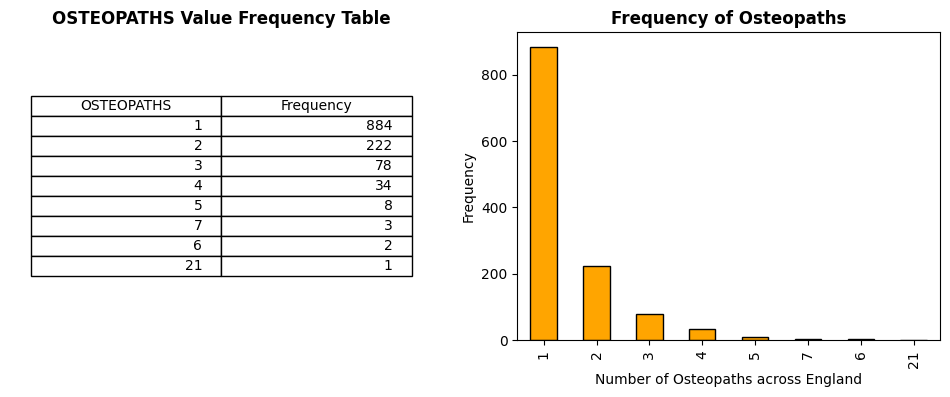

In [ ]:
# LEFT SIDE: FRECUENCY TABLE

# What is the number of 'OSTEOPATHS' values, and how often do they repeat (count) across England?
# Observe values in 'OSTEOPATHS' column and in 'count' the frequency of each value.
Frequency_Practitioners=Dr_Practitioners['OSTEOPATHS'].value_counts()

# Generate a subplot consisting of 1 row and 2 columns to display the attribute table and a descriptive graph on the right.
fig, axs = plt.subplots(1, 2, figsize=(12, 4))

# Left side: Table
axs[0].axis('off')  # Hide the axis
table = axs[0].table(cellText=Frequency_Practitioners.reset_index().values, # Convert the value counts into a table format
                     colLabels=['OSTEOPATHS', 'Frequency'],  # Add labels to the attribute table
                     loc='center') # Positions the table in the center


table.set_fontsize(10) # Define font size
table.scale(0.9, 1.2)  # Define the Table's Dimensions: Width (x) and Length (y)
axs[0].set_title('OSTEOPATHS Value Frequency Table', fontweight='bold')  # Title in bold for the attribute table


# RIGHT SIDE: BAR PLOT

# VISUALISE 'OSTEOPATHS' VALUES FREQUENCY THROUGH BAR PLOT, customize to orange with black outline
Frequency_Practitioners.plot(kind='bar', ax=axs[1], edgecolor='black', color='orange')   # [1] defines the instructions are for the second row (bar)

# Adding titles and labels to the bar
axs[1].set_title('Frequency of Osteopaths', fontweight='bold') # Title in bold
axs[1].set_xlabel('Number of Osteopaths across England')       # Label for axis X
axs[1].set_ylabel('Frequency')                                 # Label for axis Y


# Show the plot
plt.show()

Null values

In [ ]:
#Check if any of both dataframes contain null values

print('Dr_Practitioners attribute table\n\n'  '--------------Null values\n')  # Print title and add space to enhance readability
print(Dr_Practitioners.isnull().sum())                                        # Sum all null values across rows within the column

print('\n\nLA_England attribute table\n\n'  '--------------Null values\n')    # Print title and add space to enhance readability
print(LA_England.isnull().sum())                                              # Sum all null values across rows within the column


Dr_Practitioners attribute table

--------------Null values

POSTCODE      0
OSTEOPATHS    0
X             0
Y             0
GEOMETRY      0
dtype: int64


LA_England attribute table

--------------Null values

LAD11CD       0
LAD11NM       0
Shape_Leng    0
Shape_Area    0
geometry      0
dtype: int64


**2.3 DATA CLEANING: Dr_Practtioners (points) & LA_England (polygons)**
- Rename and reorder columns, round values, update CRS, and dissolve boundaries

 Dr_Practtioners (points): Calculate area in hectares, rename and reorder columns

In [ ]:
# RENAME COLUMNS in 'DR_PRACTITIONERS' attribute table for enhanced clarity and spatial analysis
# Update Column Names as Follows: 'ADJUSTEDPC' → 'POSTCODE', 'EASTING' → 'X', 'NORTHING' → 'Y',  'geometry' → 'GEOMETRY'

Dr_Practitioners.rename(columns={	'ADJUSTEDPC':'POSTCODE','EASTING': 'X', 'NORTHING': 'Y',  'geometry': 'GEOMETRY'}, inplace=True)

desired_order = [ 'POSTCODE','OSTEOPATHS','X','Y', 'GEOMETRY']      # Define columns order

Dr_Practitioners = Dr_Practitioners .reindex(columns=desired_order) # Update attribute table 'Dr_Practitioners'

# Check that the names have been modified, view first five rows:
Dr_Practitioners.head()

# Note: X and Y Columns Are Required for Kernel Density Mapping to Function Properly – This Will Be Performed Later in the Project


,POSTCODE,OSTEOPATHS,X,Y,GEOMETRY
0,AL3 5EP,3,514667,207539,POINT (514667 207539)
1,AL4 0AH,1,517272,206456,POINT (517272 206456)
2,AL4 8HY,1,515972,214800,POINT (515972 214800)
3,AL4 8JD,1,515644,214970,POINT (515644 214970)
4,AL5 1QQ,1,514301,213313,POINT (514301 213313)


LA_England (polygons): Rename columns, change columns order, round areas, and length.

In [ ]:
# RENAME Columns in 'LA_England' Data as Follows: 'LAD11CD' → 'CODE_LAD', 'LAD11NM' → 'DISTRICT', 'Shape_Area' → 'AREA_HA', 'Shape_Leng' → 'SHP_LENGTH', and 'geometry' → 'GEOMETRY_LA'
LA_England.rename(columns={'LAD11CD':'CODE_LAD','LAD11NM':'DISTRICT','Shape_Area':'AREA_HA','Shape_Leng':'SHP_LENGTH','geometry':'GEOMETRY_LA'}, inplace=True)

# Round AREA_HA to one decimal place
LA_England['AREA_HA'] = (LA_England['AREA_HA'] / 10000).round(1)

# Round 'SHP_LENGTH' to one decimal place
LA_England['SHP_LENGTH'] = LA_England['SHP_LENGTH'].round(1)

# Change  columns order as follows:
desired_order = [ 'CODE_LAD','DISTRICT', 'AREA_HA', 'SHP_LENGTH', 'GEOMETRY_LA']

# Update 'LAD_England_Practitioners' attribute table with the new column order
LA_England= LA_England.reindex(columns=desired_order)

# Print the last two rows of the attribute table to verify that the column names have changed
LA_England.tail(2)



,CODE_LAD,DISTRICT,AREA_HA,SHP_LENGTH,GEOMETRY_LA
331,W06000021,Monmouthshire,0.0,92880.5,"MULTIPOLYGON (((345058.5 180421.699, 345022.40..."
332,W06000023,Powys,0.2,235525.5,"MULTIPOLYGON (((326793.201 232169, 326793.195 ..."


Update CRS

In [ ]:
# After renaming 'geometry' columns, the .crs attribute no longer recognized the projection of 'Dr_Practitioners' and LA_England.

# AttributeError: You are calling a geospatial method on the GeoDataFrame, but the active geometry column ('geometry') is not present.
## To debug this, I consulted Copilot for guidance on recovering the CRS of the modified DataFrame: Copilot suggested to set the renamed geometry column as the active geometry column

Dr_Practitioners = Dr_Practitioners.set_geometry('GEOMETRY')
LA_England = LA_England.set_geometry('GEOMETRY_LA')

# Verify that both geospatial data have the righ Projection. Projected CRS: EPSG:27700, British National Grid
print(Dr_Practitioners.crs, LA_England.crs)


EPSG:27700 EPSG:27700


Dissolve England's Total Boundaries

In [ ]:
# For map 1 and 2. I will use Englands boundaries as the base layer, for this I will dissolve all of the the LAD (Local Authority Districts) into one geometry
England_Boundaries=LA_England.dissolve()

# Check that the data has dissolved into one polygon
England_Boundaries


,GEOMETRY_LA,CODE_LAD,DISTRICT,AREA_HA,SHP_LENGTH
0,"MULTIPOLYGON (((91842.4 12951.304, 91851.798 1...",E06000001,Hartlepool,9838.1,65312.1


**2.4 DATA VISUALISATION:** VISUALISE KERNEL DENSITY - MAP 1


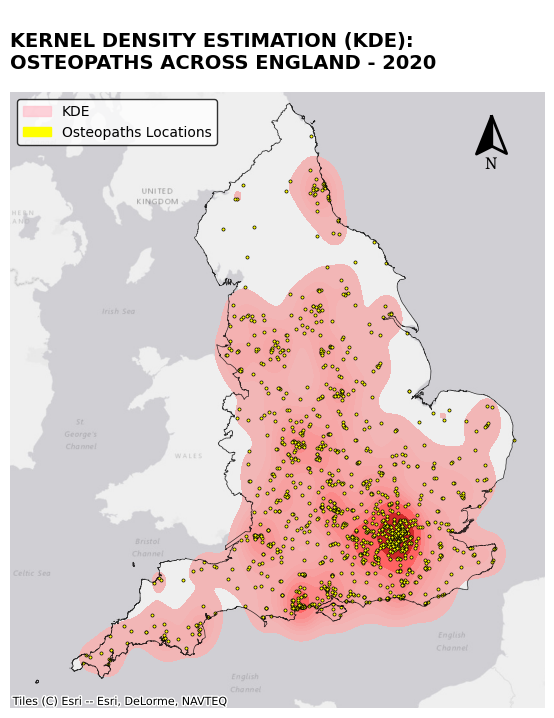

In [ ]:
# Create a KERNEL DENSITY ESTIMATE (KDE) Map to Identify High-Concentration Areas by Generating a Continuous Density Surface from Point Data (Kenchington et al., 2014)

# Reproject both GeoDataFrames to EPSG:3857 (Web Mercator)
Dr_Practitioners_proj = Dr_Practitioners.to_crs(epsg=3857)
England_Boundaries_proj = England_Boundaries.to_crs(epsg=3857)

# Create a KERNEL DENSITY ESTIMATE (KDE) Map
fig, ax = plt.subplots(figsize=(14, 8))

# Plot England's Boundaries Above All Other Layers: 'zorder' Defines Layer Order—The Higher the Value, the Higher the Layer Appears.
England_Boundaries_proj.boundary.plot(ax=ax, edgecolor='black', linewidth=0.5, color='black', alpha=0.8,zorder=4)


# Plot KDE from projected coordinates
sns.kdeplot(
    x=Dr_Practitioners_proj.geometry.x,
    y=Dr_Practitioners_proj.geometry.y,
     color='red',       # KDE color
    fill=True,          # Fill under the KDE curve
    ax=ax,              # Use existing plot axes
    bw_adjust=0.5,      # Controls KDE smoothness
    alpha=1,            # Transparency of fill
    zorder=2)           # Plot layering order



# ADD BASEMAP
#ctx.add_basemap(ax, source=ctx.providers.Esri.WorldStreetMap, crs=Dr_Practitioners_proj.crs.to_string())
ctx.add_basemap(ax, source=ctx.providers.Esri.WorldGrayCanvas, crs=Dr_Practitioners_proj.crs.to_string(), zorder=1)


# Plot Dr_Practitioners as yellow points
Dr_Practitioners_proj.plot(ax=ax, color='yellow', markersize=5, edgecolor='black', linewidth=0.5, zorder=3)


# CUSTOMIZE: TITLE, LEGEND, NORTH ARROW AND AXIS

# Add a main title, font in bold and size 14
plt.title("\nKERNEL DENSITY ESTIMATION (KDE):\nOSTEOPATHS ACROSS ENGLAND - 2020", fontweight='bold', size=14, loc='left')

# Add north arrow (unchanged from your code)
add_north_arrow(ax=ax, scale=.60, xlim_pos=0.9, ylim_pos=0.9, color='#000', text_scaler=2.2, text_yT=-1.25)

# Hide axis (coordinates)
ax.set_axis_off()


# Create a combined legend referencing KDE and Osteopaths points
# Create a patch for KDE
kde_patch = mpatches.Patch(color='pink', alpha=0.7, label="KDE") #Create a pink patch to represent KDE

legend = plt.legend(handles=[
    kde_patch,                                                            # Add label for KDE
    mpatches.Patch(color='yellow', label="Osteopaths Locations")],        # Set yellow label to represent the location points
    frameon=True, edgecolor='black')                                       # Set black outline to the legend

# Move the legend to the upper left, the default one covers the north arrow
legend.set_bbox_to_anchor((0.4, 1))


# Show the plot
plt.show()

**2.5 DATA VISUALISATION:** VISUALISE OATEOPATHS VALUES DISTRIBUTION- MAP 2

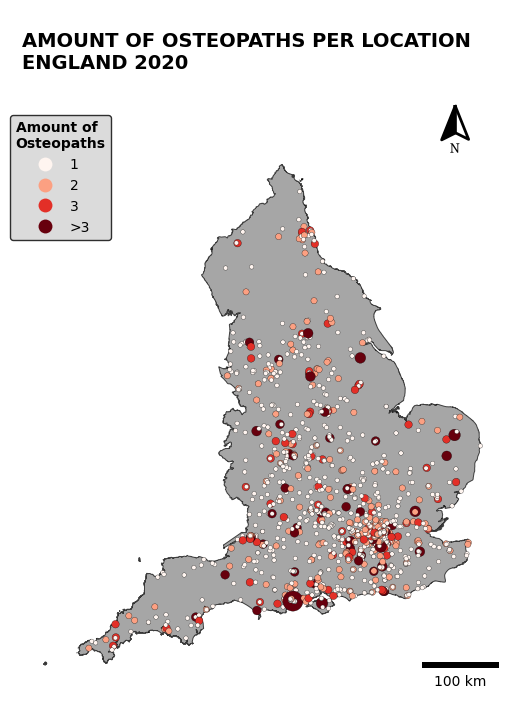

In [ ]:
# BEFORE FURTHER EXPLORING THE DATA, VISUALIZE AMMOUNT OF OSTEOPATH VALUES PER LOCATION

# Create figure and axis: set size and layout.
f, ax = plt.subplots(1, figsize=(14, 8))


# Plot 'England_Boundaries' as the basemap with custom styling, including grey fill, transparency, and defined edge color
# Instead of using LA (local authority boundaries), use the dissolved 'England_Boundaries' for a cleaner basemap.
base =England_Boundaries.plot(ax=ax, edgecolor='black', linewidth=0.7, color='grey', alpha=0.7)


# Define categories for 'Dr_Practitioners' distribution based on the number of practitioners per point
## I asked Copilot: 'How can I add a categorized legend with the following ranges: 1, 2, 3, and >3, to better visualise the distribution?
## As seen in the attribute table, some values are very high (e.g., 21), and when using default getegorization, only one colour can be visualised'
Dr_Practitioners['CATEGORIES'] = pd.cut(Dr_Practitioners['OSTEOPATHS'], bins=[0, 1, 2, 3, float('inf')], labels=['1', '2', '3', '>3'])

# When using markersize='SURGEON' in my code, the points with higher values appear larger, but overall, the marker size is very small.
##Thus, I asked Copilot how to enlarge the points without losing their ability to scale with higher values.
marker_size_factor = 10
Dr_Practitioners['scaled_markersize'] =Dr_Practitioners['OSTEOPATHS'] * marker_size_factor

# Plot Dr_Practitioners on top of the basemap with scaled marker sizes and customization such as legend, color schemes, etc.
Dr_Practitioners.plot(ax=base, markersize=Dr_Practitioners['scaled_markersize'], linewidth=0.2, cmap='Reds', edgecolor='black', legend=True, column='CATEGORIES')



# CUSTOMIZE: TITLE, LEGEND, NORTH ARROW AND AXIS

# Add a main title in bold, aligned to the left, with font size 14, using the \n function to break the text onto a new line where needed.
plt.title("\nAMOUNT OF OSTEOPATHS PER LOCATION\nENGLAND 2020", fontweight='bold', size=14, loc='left')

# Add a north arrow at the top-right axis with the letter 'N' positioned below the arrow.
add_north_arrow(ax=ax, scale=.60, xlim_pos=0.9, ylim_pos=1, color='#000', text_scaler=2, text_yT=-1.25)

# Customize the legend with a bold title, background colour and an outline for the frame
## I requested guidance from Copilot on adding color to the legend table and applying an outline for better clarity and presentation

legend = ax.get_legend()

legend.get_frame().set_edgecolor('black')  # Outline color
legend.get_frame().set_facecolor('lightgray')  # Fill color
legend.set_title('Amount of\nOsteopaths', prop={'weight': 'bold'})  # Legend title in bold

# Position legend to the upper left
legend.set_bbox_to_anchor((.20, .95))

# Hide axis (coordinates)
ax.set_axis_off()


# Add a scale bar (assuming CRS is in meters)
scalebar = ScaleBar(1, units='m', location='lower right')
ax.add_artist(scalebar)


# Export the Map: Save the Image to a Specified Path in Google Drive via Python
plt.savefig('Population.png')

# Show the plot
plt.show()


**2.6 ADVANCED DATA CLEANING:** JOIN, MERGE, CALCULATE AREA AND RECLASSIFY VALUES

**JOIN**

In [ ]:
# JOIN both datasets: (LA_ENGLAND) to (DR_PRACTITIONERS). Our Output will be the points with added  information, such as the district names.
# For this exercise we can use the default how='inner' because we just want the points that fall in Englands boundaries. If we used how='left', points outside England (if any) would remain.
Location_Practitioners= gpd.sjoin(Dr_Practitioners, LA_England, how='inner', predicate='intersects')

# Verify successful dataset joining, are all columns added?
Location_Practitioners.head()


,POSTCODE,OSTEOPATHS,X,Y,GEOMETRY,CATEGORIES,scaled_markersize,index_right,CODE_LAD,DISTRICT,AREA_HA,SHP_LENGTH
0,AL3 5EP,3,514667,207539,POINT (514667 207539),3,30,132,E07000100,St Albans,16117.6,72743.2
1,AL4 0AH,1,517272,206456,POINT (517272 206456),1,10,132,E07000100,St Albans,16117.6,72743.2
2,AL4 8HY,1,515972,214800,POINT (515972 214800),1,10,132,E07000100,St Albans,16117.6,72743.2
3,AL4 8JD,1,515644,214970,POINT (515644 214970),1,10,132,E07000100,St Albans,16117.6,72743.2
4,AL5 1QQ,1,514301,213313,POINT (514301 213313),1,10,132,E07000100,St Albans,16117.6,72743.2


In [ ]:
# AGAIN, explore the 10 largest number of practitioners per point, but now with the DISTRICT name included. There is no need to include 'POSTCODE' column.
print(Location_Practitioners.nlargest(10,'OSTEOPATHS')[['OSTEOPATHS','DISTRICT']])

# After joining both datasets, how many rows and columns do we have now? Add a sentence before the values.
print('\nNumber of rows and columns:', Location_Practitioners.shape)


     OSTEOPATHS            DISTRICT
106          21         Bournemouth
673           7             Norwich
797           7       Isle of Wight
958           7              Sutton
211           6          Chelmsford
310           6  North Lincolnshire
481           5       South Norfolk
548           5               Leeds
565           5           Maidstone
589           5       Milton Keynes

Number of rows and columns: (1232, 12)


In [ ]:
# Now we can view the total number of surgeons per district, noting that some districts have multiple points while others have none

# Group all points within the same District and sum their values instead of counting them. For example, points with values 21, 1, and 3 will sum to 25 rather than being counted as 3.
Grouped_Practitioners = Location_Practitioners.groupby('DISTRICT')['OSTEOPATHS'].sum().reset_index(name='OSTEOPATHS_TOTAL')

# Identify the Top 10 Districts with the Highest Number of Surgeons After Aggregating the Joined Dataset
Grouped_Practitioners .nlargest(10,'OSTEOPATHS_TOTAL')[['OSTEOPATHS_TOTAL','DISTRICT']]

# Note: The output is a non-spatial dataset.



,OSTEOPATHS_TOTAL,DISTRICT
21,43,Bournemouth
269,31,Wiltshire
29,28,"Bristol, City of"
55,28,Cornwall
16,27,Birmingham
146,25,New Forest
28,22,Brighton and Hove
257,20,Waverley
192,19,Sheffield
205,19,South Oxfordshire


**MERGE**

In [ ]:
# MERGE the Non-Spatial Dataset 'Grouped_Practitioners ' with the Spatial Dataset 'LA_England (Districts)',
# to Create the New Merged Output: 'LAD_England_Practitioners' DataFrame with Total Practitioners per District:

LAD_England_Practitioners=pd.merge(LA_England,Grouped_Practitioners ,left_on='DISTRICT',right_on='DISTRICT',how='left')

# Note: After merging the spatial data with 'Grouped_Practitioners', the 'Practitioners_total' column was converted by default from integer to float, resulting in decimal values (e.g., 2.0).

# Check if the merge function worked properly by observing the districts with the five smallest number of practitioners.
LAD_England_Practitioners.nsmallest(5,'OSTEOPATHS_TOTAL')[['OSTEOPATHS_TOTAL','DISTRICT']]

# Note: If any districts lack data points, they will appear as NaN (null) values because the how='left' function preserves values from the left table that do not have a match on the right.


,OSTEOPATHS_TOTAL,DISTRICT
1,1.0,Middlesbrough
4,1.0,Darlington
11,1.0,North East Lincolnshire
33,1.0,Thurrock
62,1.0,Fenland


In [ ]:
# After MERGING both datasets, how many null values does 'LAD_England_Practitioners' have? Summ the values and print answer with text for better readability
print('\n\n',LAD_England_Practitioners['OSTEOPATHS_TOTAL'].isnull().sum(), ' rows containing NaN (null) values: This means that 50 districts has no points (osteopaths)\n') # Add total number and text to enhance readability

# Display a random sample of 10 rows with NaN values
print('\n', LAD_England_Practitioners[LAD_England_Practitioners['OSTEOPATHS_TOTAL'].isnull()].sample(10))





 50  rows containing NaN (null) values: This means that 50 districts has no points (osteopaths)


       CODE_LAD              DISTRICT  AREA_HA  SHP_LENGTH  \
139  E07000107              Dartford   7631.0     52447.1   
155  E07000123               Preston  14294.5     71123.2   
101  E07000069          Castle Point   6317.6     44017.1   
329  W06000006               Wrexham      0.1     99690.8   
127  E07000095            Broxbourne   5143.5     38994.9   
66   E07000027     Barrow-in-Furness  13204.7     79757.3   
2    E06000003  Redcar and Cleveland  25388.1    101070.6   
177  E07000145        Great Yarmouth  18211.2     85272.5   
188  E07000156        Wellingborough  16303.6     69617.8   
327  S12000026      Scottish Borders      2.1    151308.5   

                                           GEOMETRY_LA  OSTEOPATHS_TOTAL  
139  POLYGON ((561023.297 177031.301, 561023.297 17...               NaN  
155  POLYGON ((357694.304 444367.3, 357679.3 444348...               NaN  
10

In [ ]:
# Fill NaN with 0 and Convert 'OSTEOPATHS_TOTAL' to Integer, Since Integer Columns Cannot Store NaN Values and Direct Conversion Would Fail".
LAD_England_Practitioners['OSTEOPATHS_TOTAL'] = LAD_England_Practitioners['OSTEOPATHS_TOTAL'].fillna(0).astype(int)

# Check if the null values were replaced by zeros. Print answer with text
print('\n',LAD_England_Practitioners['OSTEOPATHS_TOTAL'].isnull().sum(), ' rows containing NaN (null) values\n') # Add total number and text to enhance readability

# To not occupy too much space, check the last 4 rows of the 'SURGEONS_TOTAL' column.
LAD_England_Practitioners.nsmallest(4, 'OSTEOPATHS_TOTAL')

# Notes:
# To check all of the 50 districts that do not contain Surgeons Practitioners use the following code:
# LAD_England_Practitioners.loc[LAD_England_Practitioners['Practitioners_total']==0]



 0  rows containing NaN (null) values



,CODE_LAD,DISTRICT,AREA_HA,SHP_LENGTH,GEOMETRY_LA,OSTEOPATHS_TOTAL
2,E06000003,Redcar and Cleveland,25388.1,101070.6,"POLYGON ((478368.2 518993.992, 478368.2 518986...",0
5,E06000006,Halton,9032.4,60649.6,"POLYGON ((354161.5 387836.6, 354160.299 387821...",0
8,E06000009,Blackpool,4315.1,36304.8,"POLYGON ((333572.802 437130.696, 333505.099 43...",0
52,E06000053,Isles of Scilly,746.2,28562.5,"POLYGON ((91685.603 13003.298, 91703.295 12980...",0


RECLASSIFICATION (NEW VARIABLE)

In [ ]:
# Reclassify 'LAD_England_Practitioners' to enhance readability and visualization of practitioner distribution across districts.
# Reclassify 'Practitioners_total' using pd.cut and bins functions
LAD_England_Practitioners['OSTEOPATHS_RECLASS'] = pd.cut(LAD_England_Practitioners['OSTEOPATHS_TOTAL'], bins=[-1, 0, 5, 10, 15, float('inf')],
                                                       labels=['0', '1-5', '6-10', '11-15', '>15'], include_lowest=True) # Define categories

# Briefly check the frecuency of each category ('OSTEOPATHS_RECLASS')
print('RECLASSIFIED NUMBER CATEGORIES OF OSTEOPATHS') # Add title to introduce output
print(LAD_England_Practitioners['OSTEOPATHS_RECLASS'].value_counts(),'\n\n') # Add a double space below for better visual presentation


# Verify that the new column 'OSTEOPATHS_RECLASS' was added to the attribute
print('ATTRIBUTE TABLE: NEW COLUMN ORDER') # Add title to introduce output
LAD_England_Practitioners.loc[LAD_England_Practitioners['DISTRICT']=='Birmingham'] #Select the district of 'Birmingham'


RECLASSIFIED NUMBER CATEGORIES OF OSTEOPATHS
OSTEOPATHS_RECLASS
1-5      154
6-10      89
0         50
11-15     21
>15       19
Name: count, dtype: int64 


ATTRIBUTE TABLE: NEW COLUMN ORDER


,CODE_LAD,DISTRICT,AREA_HA,SHP_LENGTH,GEOMETRY_LA,OSTEOPATHS_TOTAL,OSTEOPATHS_RECLASS
281,E08000025,Birmingham,26778.6,106101.3,"POLYGON ((414454.003 298914.701, 414457.702 29...",27,>15


REARRANGE COLUMN ORDER, CALCULATE AREA, AND ROUND VALUES

In [ ]:
# Change  columns order as follows:
desired_order = [ 'CODE_LAD','DISTRICT', 'OSTEOPATHS_TOTAL','OSTEOPATHS_RECLASS','AREA_HA', 'SHP_LENGTH', 'GEOMETRY_LA']

# Update 'LAD_England_Practitioners' attribute table with the new column order
LAD_England_Practitioners = LAD_England_Practitioners.reindex(columns=desired_order)

# Check the desired order by observing in which category the District of Cornwall falls in and the total amount of Osteopaths 'OSTEOPATHS_TOTAL'
LAD_England_Practitioners.loc[LAD_England_Practitioners['DISTRICT']=='Cornwall'] # Filter the distric of Cornwall


,CODE_LAD,DISTRICT,OSTEOPATHS_TOTAL,OSTEOPATHS_RECLASS,AREA_HA,SHP_LENGTH,GEOMETRY_LA
51,E06000052,Cornwall,28,>15,361328.5,785647.8,"MULTIPOLYGON (((166106.399 17616.4, 166106.407..."


**2.7 DATA VISUALISATION:**  TOTAL AMMOUNT OF OSTEOPATH PER DISTRICT - MAP 3

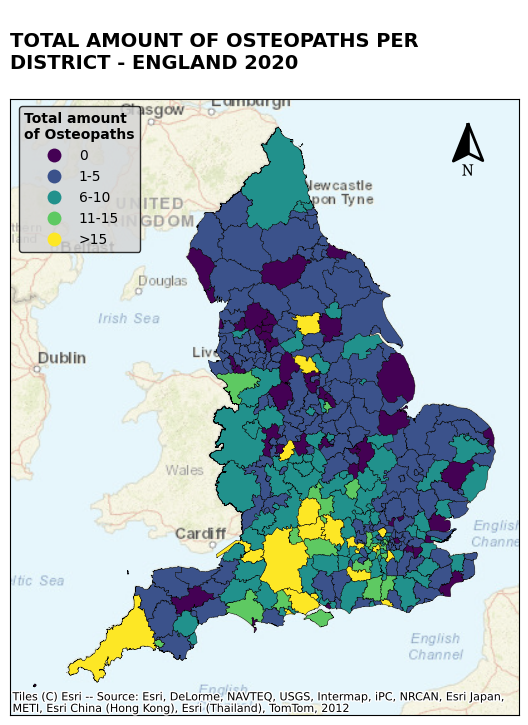

In [ ]:
# Reproject both GeoDataFrames to EPSG:3857 (Web Mercator), this step is crucial if a base map will be added
LAD_England_Practitioners_proj = LAD_England_Practitioners.to_crs(epsg=3857)

# Plotting the results: Define map size, add legend and column reference, define layer color, edgecolor, and linewidth
f, ax = plt.subplots(1, figsize=(14, 8))
LAD_England_Practitioners_proj.plot(ax=ax, legend=True, cmap='viridis', linewidth=0.3, column='OSTEOPATHS_RECLASS', edgecolor='black')

# Add WorldStreetMap as the base map
ctx.add_basemap(ax, source=ctx.providers.Esri.WorldStreetMap, crs=LAD_England_Practitioners_proj.crs.to_string(), alpha=0.7,zoom=6)

# CUSTOMIZE: TITLE, LEGEND, NORTH ARROW AND AXIS
# Add a main title in bold, aligned to the left, with font size 14, using the \n function to break the text onto a new line where needed.
plt.title("\nTOTAL AMOUNT OF OSTEOPATHS PER \nDISTRICT - ENGLAND 2020\n", fontweight='bold', size=14, loc='left')

# Add a north arrow at the top-right axis with the letter 'N' positioned below the arrow.
add_north_arrow(ax=ax, scale=.60, xlim_pos=0.9, ylim_pos=0.9, color='#000', text_scaler=2.2, text_yT=-1.25)

# Customize the legend with a bold title, background colour and an outline for the frame
legend = ax.get_legend()
legend.get_frame().set_edgecolor('black')  # Outline color
legend.get_frame().set_facecolor('lightgray')  # Fill color
legend.set_title('Total amount\nof Osteopaths', prop={'weight': 'bold'})  # Legend title in bold

# Position legend to the upper left
legend.set_bbox_to_anchor((.27, 1))

# Customize Axes: Keep Axis Outlines While Removing Labels and Ticks
ax.set_xticks([])  # Hide x-axis numbers and ticks
ax.set_yticks([])  # Hide y-axis numbers and ticks

# Show the plot
plt.show()



**2.8 FURTHER ANALYSIS:** CREATE A **BUFFER** OF 6KM AND INTERSECT WITH DISTRICTS

In [ ]:
# Create a 6 km Buffer around the Osteptahs locations in order to Identify Districts Without Intersection — Highlighted in the Final Map as Having No Access to Osteopaths
Buff_Osteo_6km_Dr=Dr_Practitioners.buffer(distance=6000)

# JOIN the buffer with LAD_England_Practitioners.
# The process gave a ValueError: 'right_df' should be GeoDataFrame, got <class 'geopandas.geoseries.GeoSeries'>
## I asked Copilot: 'Guide me on how to convert my data to a GeodataFrame
Buff_Osteo_6km_Dr = gpd.GeoDataFrame(Buff_Osteo_6km_Dr, geometry=Buff_Osteo_6km_Dr.geometry)

# JOIN both datasets: use how='left' so that the Districts that don't intersect will remain as Nan values.
Intersection_Buffer= gpd.sjoin(LAD_England_Practitioners, Buff_Osteo_6km_Dr, how='left', predicate='intersects') #, using the intersection function

# Verify successful dataset joining, how many null values are there? Null values represent districts that did not intersect the buffer of 6 km.
print(Intersection_Buffer.isnull().sum())


CODE_LAD               0
DISTRICT               0
OSTEOPATHS_TOTAL       0
OSTEOPATHS_RECLASS     0
AREA_HA                0
SHP_LENGTH             0
GEOMETRY_LA            0
index_right           12
0                     12
dtype: int64


New column 'ACCESSIBILITY'

In [ ]:
# Add a New Column Named 'ACCESSIBILITY' to the Joined Dataset 'No_Access_Osteopaths'
# Assign 'YES' to Districts Intersecting the Buffer and 'NO' to Those That Do Not
Intersection_Buffer['ACCESSIBILITY'] = Intersection_Buffer['index_right'].isnull().map({True: 'NO', False: 'YES'})

# Print out the districts that has 'NO' values
print(Intersection_Buffer.loc[Intersection_Buffer['ACCESSIBILITY'] == 'NO', ['DISTRICT', 'ACCESSIBILITY']])


                DISTRICT ACCESSIBILITY
52       Isles of Scilly            NO
66     Barrow-in-Furness            NO
68              Copeland            NO
149              Burnley            NO
154               Pendle            NO
172        South Holland            NO
177       Great Yarmouth            NO
182                Corby            NO
326  Dumfries & Galloway            NO
327     Scottish Borders            NO
329              Wrexham            NO
330              Cardiff            NO


**2.9 DATA VISUALISATION: Districts that don't intersect with osteopaths' 6 km buffer zone – Map 4**

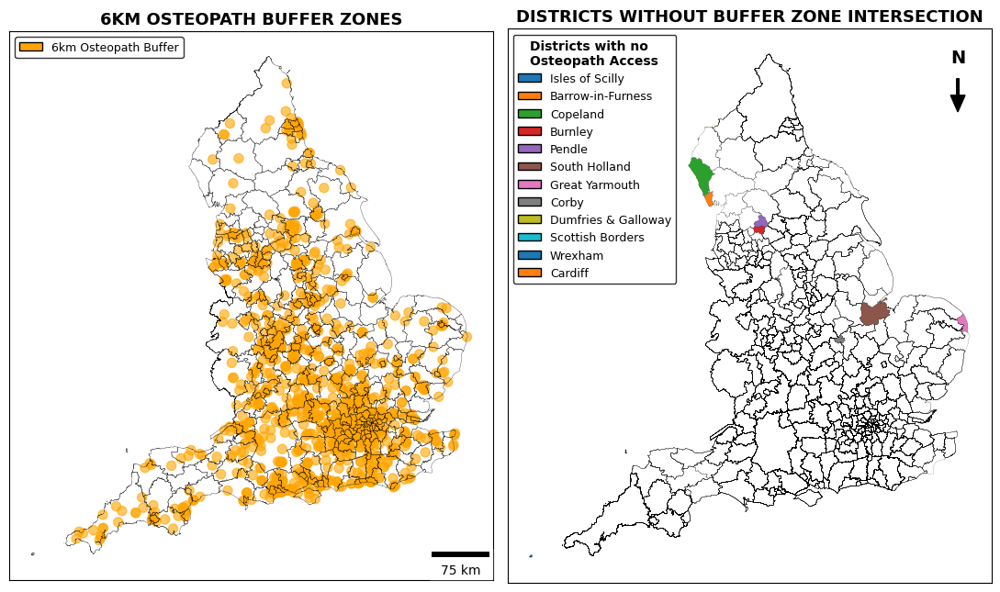

In [ ]:
# Filter Districts That Don't Intersect with Osteopath Buffers and Assign a Simple Color Scheme
No_intersection= Intersection_Buffer[Intersection_Buffer['ACCESSIBILITY'] == 'NO'].copy()  # Create a new dataset 'No_intersection'

## I asked Chat GPT 4.0: modifify my code so that each district that has can have a differetn color
# Assign a unique color to each district in No_intersection using a colormap
colors = cm.tab10.colors
color_list = [colors[i % len(colors)] for i in range(len(No_intersection))]
No_intersection['color'] = color_list

# Create the figure and side-by-side subplots
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(11, 8))  # define map layout size and structure (one row and two columns)


#  ========== LEFT MAP: Buffer Zones ==========

# Plot Districts boundaries with black outline and no filling (.boundary), customize edgecolor, width, transparency and layer order (zorder).
LAD_England_Practitioners.boundary.plot(ax=ax1, edgecolor='black', linewidth=0.3, alpha=0.7, zorder=2)

# Plot 6km buffer zones below boundaries and customize with orange fill below boundaries
Buff_Osteo_6km_Dr.plot(ax=ax1, edgecolor='orange', color='orange', alpha=0.6, zorder=1, label='6km Osteopath Buffer')

# Add the main title in bold and define fontsize
ax1.set_title("6KM OSTEOPATH BUFFER ZONES", fontweight='bold', fontsize=13)

# Remove axis ticks and labels, but keep axis box
ax1.set_xticks([])
ax1.set_yticks([])
ax1.tick_params(left=False, bottom=False)

# Add legend with black box around it
## I asked Copilot: How can I add legend to a non categorical data?
legend1 = ax1.legend(
    handles=[Patch(facecolor='orange', edgecolor='black', label='6km Osteopath Buffer')],
    loc='upper left', frameon=True, fontsize=9, title_fontsize=10)

legend1.get_frame().set_edgecolor('black')  # Add black border to legend box

# Add scalebar in lower right, define unit in m
ax1.add_artist(ScaleBar(1, units='m', location='lower right', scale_loc='bottom', length_fraction=0.15))


# ========== RIGHT MAP: Accessibility ==========

# Plot Districts That Intersect ('YES') with the Buffer Zone Using a Black Outline, use 'ACCESSIBILITY' column
Intersection_Buffer[Intersection_Buffer['ACCESSIBILITY'] == 'YES'].plot(
    ax=ax2, facecolor='none', edgecolor='black', linewidth=0.1);

# Plot No_intersection dataset, districts that did no interset with buffers zone, with distinct colors and plot it on top (zorder=2)
No_intersection.plot(ax=ax2, color=No_intersection['color'], edgecolor='black', linewidth=0.1,zorder=2)

# Add main title
ax2.set_title("DISTRICTS WITHOUT BUFFER ZONE INTERSECTION", fontweight='bold', fontsize=13)

# Remove ticks and labels, but keep axis box
ax2.set_xticks([])
ax2.set_yticks([])
ax2.tick_params(left=False, bottom=False)

# Add the north arrow to the upper right and customize lenght and width
## Using 'add_north_arrow(ax=ax)' did not work, so I asked Copilot, to provide an alternative code  for the right map.
ax2.text(0.93, 0.94, 'N', transform=ax2.transAxes,
         fontsize=14, fontweight='bold', ha='center')
ax2.add_patch(FancyArrow(0.93, 0.91, 0, -0.06,
                         transform=ax2.transAxes,
                         width=0.005,
                         head_width=0.03,
                         head_length=0.03,
                         length_includes_head=True,
                         color='black'))

# Create custom legend listing district names with no access to Osteopaths, customize with title, fontsize, and column ('DISTRICT') as reference
# Customize title, fontsize, position and edgecolor
legend2 = ax2.legend(
    handles=[Patch(facecolor=color_list[i], edgecolor='black', label=name)
    for i, name in enumerate(No_intersection['DISTRICT'])],
    title="Districts with no\nOsteopath Access",
    title_fontsize=10,
    loc='upper left',
    frameon=True,
    fontsize=9)

# Make the legend title bold
legend2.get_title().set_fontweight('bold')

# Add black outline to legend box
legend2.get_frame().set_edgecolor('black')


# Final layout adjustment
plt.tight_layout()             # Automatically adjusts space so all subplots fit well in the figure
plt.show()                     # Display maps


### Block Two Submission

For Block 2, a geospatial dataset from the University of Leeds and GOV.UK was used, consisting of two shapefiles: the locations of osteopath practitioners across England (points) and the Local Authority Districts (LADs) of England (polygons). To facilitate spatial processing, both datasets were converted to **GeoJSON format**. As noted by Michael (2020), GeoJSON is compatible with web technologies and features a structured, lightweight design, making it easier to manage, share, and render in both static and interactive maps.

Beyond data exploration, extensive** geo-preprocessing** was conducted. This included data cleaning (handling null values by removing or converting them to 0), column reordering and renaming, coordinate system projection, and advanced spatial processing such as dissolving boundaries, spatial joins, dataset merging, reclassification, and buffering. New variables were created to visualize the total number of osteopaths per district and to identify districts that do not intersect with a 6 km buffer around osteopath locations—highlighting areas lacking access to services.

**Key packages** used included Pandas and GeoPandas for managing and analyzing tabular and spatial data, and Matplotlib (with Patch, FancyArrow, and cm) for customizing legends, symbols, and colors. Contextily was used to add basemaps, while matplotlib-scalebar and geo_northarrow enhanced map interpretation with scale bars and north arrows.These maps integrated essential cartographic elements such as titles, legends, basemaps:

Given the spatial nature of the data, static maps were selected as the most effective medium to visualize multiple data layers. The final outputs were presented as: **Map 1**, a thematic point map of osteopath distribution;
**Map 2**, a kernel density heatmap showing concentration patterns;
**Map 3**, a choropleth map of total osteopaths per district; and
**Map 4**, a buffer-based accessibility map highlighting districts without osteopath access. Together, these visualizations offer clear insights into service distribution and potential gaps in accessibility across England.





## REFERENCES AND ACKNOWLEDGEMENTS

1) Bachthaler, S. and Weiskopf, D. 2008. Continuous scatterplots. IEEE Transactions on Visualization and Computer Graphics [Online], 14(6), pp.1428–1435. [Accessed 24 March 2025]. Available from: https://doi.org/10.1109/TVCG.2008.119

2) Dorman, M. 2020. Introduction to web mapping [Online]. Boca Raton: CRC Press. [Accessed 24 March 2025]. Available from: https://www.perlego.com/

3) Kenchington, E., Murillo, F.J., Lirette, C., Sacau, M., Koen-Alonso, M., Kenny, A., Ollerhead, N., Wareham, V. and Beazley, L. 2014. Kernel density surface modelling as a means to identify significant concentrations of vulnerable marine ecosystem indicators. Public Library of Science (PLoS) [Online], 9(10), article no: e0109365 [no pagination]. [Accessed 24 March 2025]. Available from: https://doi.org/10.1371/journal.pone.0109365


4) I acknowledge the use of ChatGPT-4.0 (OpenAI, https://chat.openai.com/, accessed March 23, 2025) to assist with generating Python code for map visualization using GeoPandas, including the creation of legends and north arrows.

Prompts used:

• Prompt: Modify my code so that each district with a value of ‘NO’ has a distinct color.

• Prompt: “Help me define an interval of 5 years for axis ticks (the default has an interval of 10 years); to run this code, I had to import NumPy.”

• Prompt: How can I add space between the lists of countries and years to improve visualization in my output?



5) I acknowledge the use of GitHub Copilot (Microsoft, https://github.com/features/copilot, accessed March 20, 2025) to assist in debugging map rendering errors in GeoPandas.

**Visualisation Prompts:**

• Prompt: How do I add space between the lists of countries and years to improve visualization in my output?

• Prompt: How do I rotate x-axis labels 90 degrees for better readability?

• Prompt: Which function should I use to calculate percentage change between values in a data frame?

• Prompt: How can I add both an outline and fill color to my legend box to improve readability?

• Prompt: How do I add a custom text label to the output of the .nunique() function in a Pandas DataFrame?

• Prompt: How can I create a categorized legend using value ranges: 1, 2, 3, and >3 to visualise the data distribution better?

• Prompt: How do I enlarge plotted points in GeoPandas without losing the ability to scale them based on value magnitude?

• Prompt: How can I color-code the entries in my legend table and apply an outline for improved clarity and presentation?

• Prompt: How can I add a legend to a plot that uses non-categorical data in GeoPandas?

• Prompt: How can I modify my code so that each district with a value of ‘NO’ is displayed in a distinct color?

**Error Debugging & Fix Prompts:**

• Prompt: How can I recover the CRS after renaming the geometry column in a GeoDataFrame?

• Prompt: I'm getting the error: AttributeError: You are calling a geospatial method on the GeoDataFrame, but the active geometry column ('geometry') is not present. How do I correctly set a renamed column as the active geometry column in GeoPandas?

• Prompt: How do I resolve the error: ValueError: 'right_df' should be GeoDataFrame, got <class 'geopandas.geoseries.GeoSeries'>? What is the proper way to convert a pandas DataFrame or GeoSeries into a valid GeoDataFrame for spatial operations such as spatial joins or plotting?
